In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
import io
import wandb
from wandb.keras import WandbCallback

import datetime
from datetime import datetime
import albumentations as A
import tensorflow as tf
import tensorflow_datasets as tfds
import tensorflow_probability as tfp
from tensorflow.keras.layers import Layer
from tensorflow.keras.models import Model
from tensorflow.keras.layers import InputLayer, Conv2D,MaxPool2D, Dense, Flatten, BatchNormalization, Input, Dropout, RandomFlip, RandomRotation, RandomContrast, Resizing, Rescaling
from tensorflow.keras.metrics import BinaryAccuracy, FalsePositives, FalseNegatives, TruePositives, TrueNegatives, Precision, Recall, AUC
from tensorflow.keras.losses import BinaryCrossentropy
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import Callback, CSVLogger, EarlyStopping, LearningRateScheduler, ModelCheckpoint, ReduceLROnPlateau, TensorBoard
from tensorflow.keras.regularizers import L1,L2
from tensorboard.plugins.hparams import api as hp
import sklearn
from sklearn.metrics import confusion_matrix, roc_curve

## Wandb Install , Login , Initialization & Configs

In [ ]:
!pip install wandb

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 7.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 190.6/190.6 kB 16.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 254.1/254.1 kB 25.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 8.5 MB/s eta 0:00:00


In [ ]:
!wandb login

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit: 
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
wandb.init(
    project="Malaria-Detection",
    entity='Abubakar-00'
)

wandb: Currently logged in as: abubakar-00. Use `wandb login --relogin` to force relogin


In [ ]:
wandb.config = {
  "LEARNING_RATE": 0.001,
  "N_EPOCHS": 5,
  "BATCH_SIZE": 128,
  "DROPOUT_RATE": 0.0,
  "IM_SIZE": 224,
  "REGULARIZATION_RATE": 0.0,
  "N_FILTERS": 6,
  "KERNEL_SIZE": 3,
  "N_STRIDES": 1,
  "POOL_SIZE": 2,
  "N_DENSE_1": 100,
  "N_DENSE_2": 10,
}
CONFIGURATION = wandb.config

## DataSet Import

In [ ]:
dataset, dataset_info = tfds.load('malaria',with_info=True, as_supervised=True, shuffle_files=True, split=['train'])

Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Extraction completed...: 0 file [00:00, ? file/s]

Generating splits...:   0%|          | 0/1 [00:00<?, ? splits/s]

Generating train examples...:   0%|          | 0/27558 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/malaria/1.0.0.incompleteW5UAUZ/malaria-train.tfrecord*...:   0%|          …

Dataset malaria downloaded and prepared to /root/tensorflow_datasets/malaria/1.0.0. Subsequent calls will reuse this data.


In [ ]:
dataset

[<_PrefetchDataset element_spec=(TensorSpec(shape=(None, None, 3), dtype=tf.uint8, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>]

In [ ]:
for data in dataset[0].take(4):
  print(data)

(<tf.Tensor: shape=(103, 103, 3), dtype=uint8, numpy=
array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]]], dtype=uint8)>, <tf.Tensor: shape=(), dtype=int64, numpy=0>)
(<tf.Tensor: shape=(115, 157, 3), dtype=uint8, numpy=
array([[[0, 0, 0],
        [0, 0, 0],
       

## DATA PIPELINE


In [ ]:
def splits(dataset ,TRAIN_RATIO, VAL_RATIO, TEST_RATIO):
  DATASET_SIZE = len(dataset)
  #dataset = tf.data.Dataset.from_tensor_slices(dataset)

  train_dataset = dataset.take(int(TRAIN_RATIO * DATASET_SIZE))

  val_test_dataset = dataset.skip(int(TRAIN_RATIO * DATASET_SIZE))
  val_dataset = val_test_dataset.take(int(VAL_RATIO * DATASET_SIZE))

  test_dataset = val_test_dataset.skip(int(VAL_RATIO * DATASET_SIZE))

  return train_dataset, val_dataset, test_dataset

In [ ]:
TRAIN_RATIO = 0.8
VAL_RATIO = 0.1
TEST_RATIO = 0.1

#dataset = tf.data.Dataset.range(10)
train_dataset, val_dataset, test_dataset = splits(dataset[0] ,TRAIN_RATIO, VAL_RATIO, TEST_RATIO)
# print(list(train_dataset.take(1).as_numpy_iterator()),
#       list(val_dataset.take(1).as_numpy_iterator()),
#       list(test_dataset.take(1).as_numpy_iterator())
#      )

## DATA VISUALIZATION

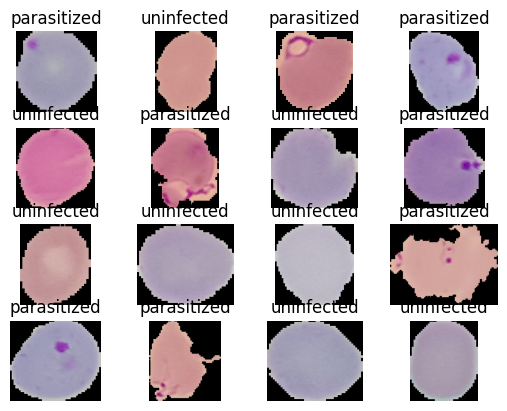

In [ ]:
for i, (image, label) in enumerate(train_dataset.take(16)):
  ax = plt.subplot(4, 4, i + 1)

  plt.imshow(image)
  plt.title(dataset_info.features['label'].int2str(label))
  plt.axis('off')

**Data Preprocessing**

## Data Augmentation

In [ ]:
def visualize(original, augmented):
  plt.subplot(1,2,1)
  plt.imshow(original)

  plt.subplot(1,2,2)
  plt.imshow(augmented)

In [ ]:
original_image, label = next(iter(train_dataset))

In [ ]:
augumented_image = tf.image.random_flip_up_down(original_image)

In [ ]:
augumented_image = tf.image.central_crop(original_image, 0.8)

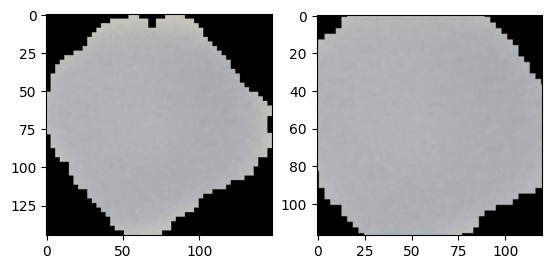

In [ ]:
visualize(original_image, augumented_image)

In [ ]:
IM_SIZE = 224
def resize_rescale(image, label):
  return tf.image.resize(image, (IM_SIZE, IM_SIZE))/255.0, label

In [ ]:
IM_SIZE = 224

In [ ]:
### tf.keras.layer resizing & rescaling
resize_rescale_layers = tf.keras.Sequential([
       Resizing(IM_SIZE,IM_SIZE),
       Rescaling(1.0/255)
])

In [ ]:
### tf.image augument
def augument(image, label):
  image, label = resize_rescale(image, label)

  image = tf.image.rot90(image)
  #image = tf.image.adjust_saturation(image, saturation_factor = 0.3)
  image = tf.image.flip_left_right(image)
  return image,label

## Custom Layers

In [ ]:
class RotNinety(Layer):
  def __init__(self):
      super().__init__()

  def call(self, image):
    return tf.image.rot90(image)

In [ ]:
### tf.keras.layer augument
augment_layers = tf.keras.Sequential([
       RotNinety(), ## Custom func
       RandomFlip(mode='horizontal',),
])
def augment_layer(image, label):
  return augment_layers(resize_rescale_layers(image), training = True), label

In [ ]:
### tf.keras.layer augument
augment_layers = tf.keras.Sequential([
       RandomRotation(factor = (0.25, 0.2501),),
       RandomFlip(mode='horizontal',),
       #RandomContrast(factor=0.1),
])
def augment_layer(image, label):
  return augment_layers(resize_rescale_layers(image), training = True), label

In [ ]:
###test_dataset = test_dataset.map(resize_rescale_layers)
#train_dataset

## Data Loading

In [ ]:
BATCH_SIZE = 32
train_dataset = (
    train_dataset
    .shuffle(buffer_size = 8, reshuffle_each_iteration = True)
    .map(resize_rescale)
    .batch(BATCH_SIZE)
    .prefetch(tf.data.AUTOTUNE)
    )

In [ ]:
val_dataset = (
    val_dataset
    .shuffle(buffer_size = 8,reshuffle_each_iteration = True)
    .map(resize_rescale)
    .batch(BATCH_SIZE) # BATCH_SIZE = 1 as now we are concerned to expand one dim of actual image
)

In [ ]:
train_dataset

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int64, name=None))>

In [ ]:
val_dataset

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int64, name=None))>

## MIxup Data Augmentation

In [ ]:
IM_SIZE = 224

image_1 = cv2.resize(cv2.imread('Cat.jpg'), (IM_SIZE, IM_SIZE))
image_2 = cv2.resize(cv2.imread('Dog.jpg'), (IM_SIZE, IM_SIZE))
label_1 = 0 # Cat
label_2 = 1 # dog


lamda = tfp.distributions.Beta( 0.2, 0.2) # we got values from research paper
lamda = lamda.sample(1)[0]

image = lamda*image_1 + (1-lamda)*image_2 # x’ = λx1 + (1-λ)x2
label = lamda*label_1 + (1-lamda)*label_2 # y’ = λy1 + (1-λ)y2

print(image.shape, label)


(224, 224, 3) tf.Tensor(0.5902447, shape=(), dtype=float32)


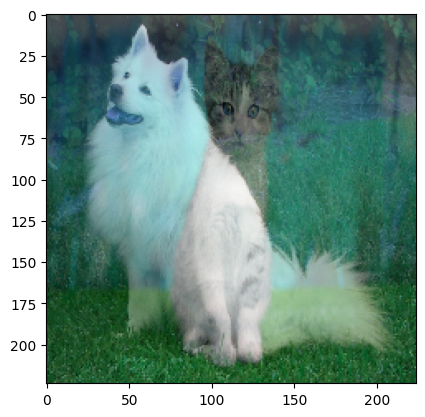

In [ ]:
plt.imshow(image/255)

In [ ]:
train_dataset_1 = train_dataset.shuffle(buffer_size = 8, reshuffle_each_iteration= True ).map(resize_rescale)
train_dataset_2 = train_dataset.shuffle(buffer_size = 8, reshuffle_each_iteration= True ).map(resize_rescale)

mixed_dataset = tf.data.Dataset.zip((train_dataset_1, train_dataset_2))

In [ ]:
def mixup(train_dataset_1, train_dataset_2):
  (image_1,label_1), (image_2, label_2) = train_dataset_1, train_dataset_2

  lamda = tfp.distributions.Beta(0.2,0.2)
  lamda = lamda.sample(1)[0]

  image = lamda*image_1 + (1-lamda)*image_2
  label = lamda*tf.cast(label_1, dtype = tf.float32) + (1-lamda)*tf.cast(label_2, dtype = tf.float32) # cast for labels
  return image, label

In [ ]:
BATCH_SIZE = 32
train_dataset = (
    mixed_dataset
    .shuffle(buffer_size = 8, reshuffle_each_iteration = True)
    #.map(mixup)
    .map(cutmix)
    .batch(BATCH_SIZE)
    .prefetch(tf.data.AUTOTUNE)
)

In [ ]:
train_dataset

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.float32, name=None))>

## CutMix Augmentation

In [ ]:
def box(lamda):

  r_x = tf.cast(tfp.distributions.Uniform(0, IM_SIZE).sample(1)[0], dtype = tf.int32)
  r_y = tf.cast(tfp.distributions.Uniform(0, IM_SIZE).sample(1)[0], dtype = tf.int32)

  r_w = tf.cast(IM_SIZE*tf.math.sqrt(1-lamda), dtype = tf.int32)
  r_h = tf.cast(IM_SIZE*tf.math.sqrt(1-lamda), dtype = tf.int32)

  r_x = tf.clip_by_value(r_x - r_w//2, 0, IM_SIZE)
  r_y = tf.clip_by_value(r_y - r_h//2, 0, IM_SIZE)

  # to deal with out going box from img, but clipped box have small dims
  x_b_r = tf.clip_by_value(r_x + r_w//2, 0, IM_SIZE)
  y_b_r = tf.clip_by_value(r_y + r_h//2, 0, IM_SIZE)

  # adjusting clipped box dims
  r_w = x_b_r - r_x
  if(r_w == 0):
    r_w  = 1

  r_h = y_b_r - r_y
  if(r_h == 0):
    r_h = 1

  return r_y, r_x, r_h, r_w

In [ ]:
def cutmix(train_dataset_1, train_dataset_2):
  (image_1,label_1), (image_2, label_2) = train_dataset_1, train_dataset_2

  lamda = tfp.distributions.Beta(0.2,0.2)
  lamda = lamda.sample(1)[0]

  r_y, r_x, r_h, r_w = box(lamda)
  crop_2 = tf.image.crop_to_bounding_box(image_2, r_y, r_x, r_h, r_w)
  pad_2 = tf.image.pad_to_bounding_box(crop_2, r_y, r_x, IM_SIZE, IM_SIZE)

  crop_1 = tf.image.crop_to_bounding_box(image_1, r_y, r_x, r_h, r_w)
  pad_1 = tf.image.pad_to_bounding_box(crop_1, r_y, r_x, IM_SIZE, IM_SIZE)

  image = image_1 - pad_1 + pad_2

  # for label
  lamda = tf.cast(1- (r_w*r_h)/(IM_SIZE*IM_SIZE), dtype = tf.float32)
  label = lamda*tf.cast(label_1, dtype = tf.float32) + (1-lamda)*tf.cast(label_2, dtype = tf.float32)

  return image, label

label is : tf.Tensor(
[1.0000000e+00 7.5444436e-01 9.6460581e-03 1.0000000e+00 7.6753825e-01
 9.9998009e-01 0.0000000e+00 1.9907951e-05 1.0000000e+00 9.9998009e-01
 2.4555564e-01 0.0000000e+00 0.0000000e+00 1.0000000e+00 1.0000000e+00
 1.0000000e+00 7.5444436e-01 1.0000000e+00 2.4555564e-01 0.0000000e+00
 0.0000000e+00 7.5444436e-01 1.0000000e+00 7.5444436e-01 0.0000000e+00
 0.0000000e+00 1.6143322e-03 9.3062419e-01 1.9907951e-05 2.4555564e-01
 9.5408165e-01 1.0000000e+00], shape=(32,), dtype=float32)


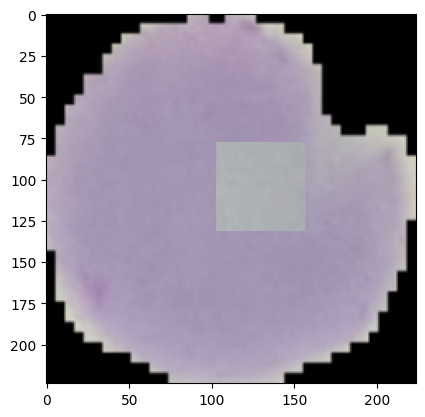

In [ ]:
original_image, label = next(iter(train_dataset))
print('label is :' ,label)
plt.imshow(original_image[0])

## Albumentation

In [ ]:
!pip install -U git+https://github.com/albu/albumentations --no-cache-dir

  Cloning https://github.com/albu/albumentations to /tmp/pip-req-build-fw8em12x
  Running command git clone --filter=blob:none --quiet https://github.com/albu/albumentations /tmp/pip-req-build-fw8em12x
  Resolved https://github.com/albu/albumentations to commit c70e664e060bfd7463c20674927aed217f72d437
  Preparing metadata (setup.py) ... done


In [ ]:
transforms = A.Compose(
    [
      A.Resize(IM_SIZE, IM_SIZE),

      A.OneOf([A.HorizontalFlip(),
                A.VerticalFlip(),], p = 0.3),

      A.RandomRotate90(),
      #A.RandomGridShuffle(grid=(3, 3), always_apply=False, p=0.5),
      A.RandomBrightnessContrast(brightness_limit=0.2,
                                contrast_limit=0.2,
                                always_apply=False, p=0.5),
      #A.Cutout(num_holes=8, max_h_size=8, max_w_size=8, fill_value=0, always_apply=False, p=0.5),
      A.Sharpen(alpha=(0.2, 0.5), lightness=(0.5, 1.0), always_apply=False, p=0.5),
])

In [ ]:
def aug_albument(image):
  data = {"image":image}
  image = transforms(**data)
  image = image["image"]
  image = tf.cast(image/255., tf.float32)
  return image

In [ ]:
def process_data(image, label):
    aug_img = tf.numpy_function(func=aug_albument, inp=[image], Tout=tf.float32)
    return aug_img, label

In [ ]:
BATCH_SIZE = 32
train_dataset = (
    train_dataset
    .shuffle(buffer_size = 8, reshuffle_each_iteration = True)
    .map(process_data)
    .batch(BATCH_SIZE)
    .prefetch(tf.data.AUTOTUNE)
)

In [ ]:
train_dataset

<_PrefetchDataset element_spec=(TensorSpec(shape=<unknown>, dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int64, name=None))>

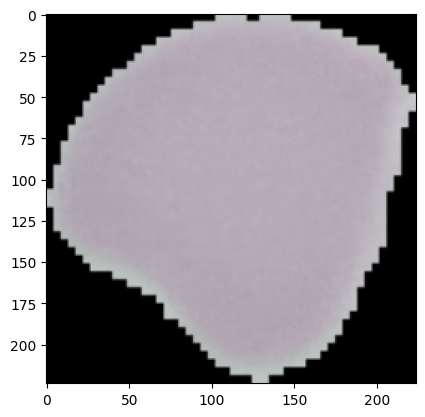

In [ ]:
im, _ = next(iter(train_dataset))
plt.imshow(im[0])

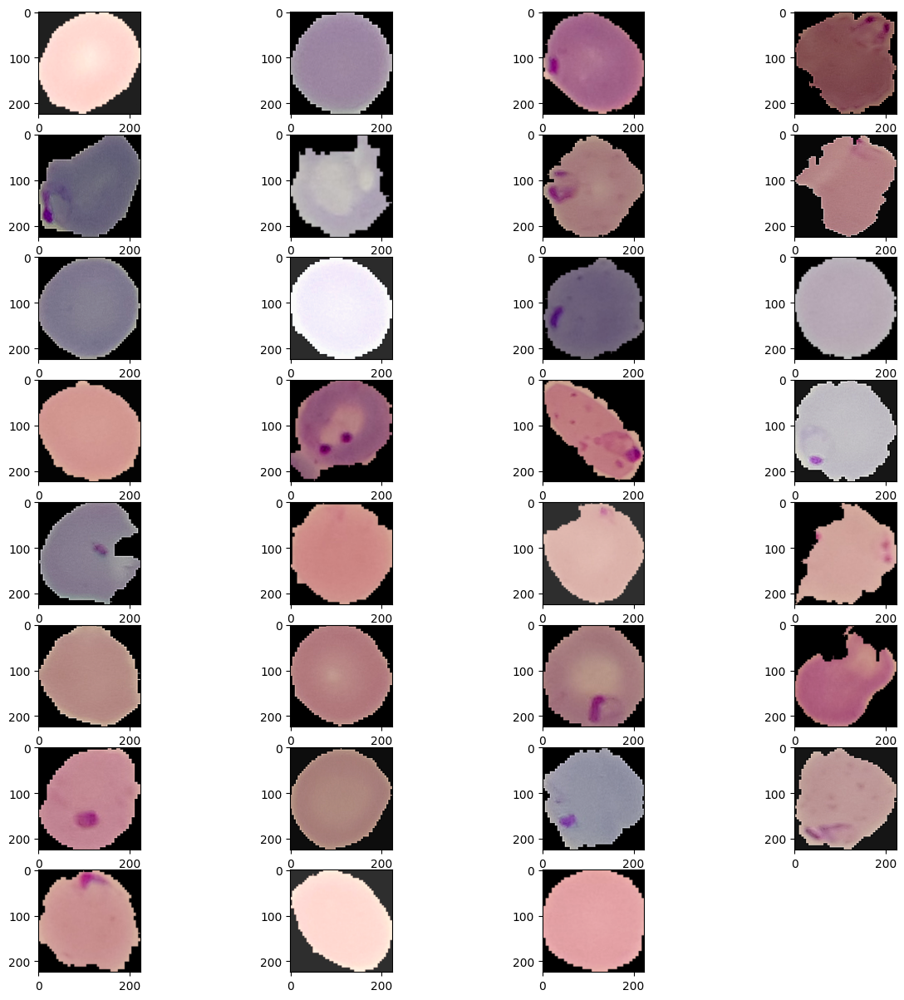

In [ ]:
plt.figure(figsize=(15,15))

for i in range(1,32):
  plt.subplot(8,4,i)
  plt.imshow(im[i])

## Data Preprocessing

In [ ]:
# Image Rescaling

IM_SIZE = 224
def resize_rescale(image, label):
  return tf.image.resize(image, (IM_SIZE,IM_SIZE))/255.0, label

In [ ]:
train_dataset = train_dataset.map(resize_rescale)
val_dataset = val_dataset.map(resize_rescale)
test_dataset = test_dataset.map(resize_rescale)
train_dataset

<_MapDataset element_spec=(TensorSpec(shape=(224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>

In [ ]:
for image, label in train_dataset.take(1):
  print(image, label)

tf.Tensor(
[[[0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]
  ...
  [0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]]

 [[0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]
  ...
  [0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]]

 [[0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]
  ...
  [0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]]

 ...

 [[0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]
  ...
  [0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]]

 [[0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]
  ...
  [0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]]

 [[0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]
  ...
  [0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]]], shape=(224, 224, 3), dtype=float32) tf.Tensor(1, shape=(), dtype=int64)


In [ ]:
train_dataset = train_dataset.shuffle(buffer_size=8, reshuffle_each_iteration=True).batch(32).prefetch(tf.data.AUTOTUNE)

In [ ]:
val_dataset = val_dataset.shuffle(buffer_size=8, reshuffle_each_iteration=True).batch(32).prefetch(tf.data.AUTOTUNE)

In [ ]:
train_dataset

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int64, name=None))>

In [ ]:
val_dataset

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int64, name=None))>

## Model Creation (LeNet)

In [ ]:
lenet_model  = tf.keras.Sequential([
                              InputLayer(input_shape = (IM_SIZE, IM_SIZE,3)),

                              Conv2D(filters=6, kernel_size=3, strides=1, padding='valid', activation='relu'),
                              BatchNormalization(),
                              MaxPool2D(pool_size=2, strides=2),

                              Conv2D(filters=16, kernel_size=3, strides=1, padding='valid', activation='relu'),
                              BatchNormalization(),
                              MaxPool2D(pool_size=2, strides=2),

                              Flatten(),

                              Dense(100, activation="relu"),
                              BatchNormalization(),
                              Dense(10, activation="relu"),
                              BatchNormalization(),
                              Dense(1, activation="sigmoid"),
])
lenet_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 222, 222, 6)       168       
                                                                 
 batch_normalization (Batch  (None, 222, 222, 6)       24        
 Normalization)                                                  
                                                                 
 max_pooling2d (MaxPooling2  (None, 111, 111, 6)       0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 109, 109, 16)      880       
                                                                 
 batch_normalization_1 (Bat  (None, 109, 109, 16)      64        
 chNormalization)                                                
                                                        

## Lenet Wandb

In [ ]:
IM_SIZE = CONFIGURATION['IM_SIZE']
DROPOUT_RATE = CONFIGURATION['DROPOUT_RATE']
REGULARIZATION_RATE = CONFIGURATION['REGULARIZATION_RATE']
N_FILTERS = CONFIGURATION['N_FILTERS']
KERNEL_SIZE = CONFIGURATION['KERNEL_SIZE']
POOL_SIZE = CONFIGURATION['POOL_SIZE']
N_STRIDES = CONFIGURATION['N_STRIDES']

lenet_model = tf.keras.Sequential([
    InputLayer(input_shape = (IM_SIZE, IM_SIZE, 3)),

    Conv2D(filters = N_FILTERS , kernel_size = KERNEL_SIZE, strides = N_STRIDES , padding='valid',
          activation = 'relu',kernel_regularizer = L2(REGULARIZATION_RATE)),
    BatchNormalization(),
    MaxPool2D (pool_size = POOL_SIZE, strides= N_STRIDES*2),
    Dropout(rate = DROPOUT_RATE ),

    Conv2D(filters = N_FILTERS*2 + 4, kernel_size = KERNEL_SIZE, strides=N_STRIDES, padding='valid',
          activation = 'relu', kernel_regularizer = L2(REGULARIZATION_RATE)),
    BatchNormalization(),
    MaxPool2D (pool_size = POOL_SIZE, strides= N_STRIDES*2),

    Flatten(),

    Dense( CONFIGURATION['N_DENSE_1'], activation = "relu", kernel_regularizer = L2(REGULARIZATION_RATE)),
    BatchNormalization(),
    Dropout(rate = DROPOUT_RATE),

    Dense( CONFIGURATION['N_DENSE_2'], activation = "relu", kernel_regularizer = L2(REGULARIZATION_RATE)),
    BatchNormalization(),

    Dense(1, activation = "sigmoid"),

])

lenet_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 222, 222, 6)       168       
                                                                 
 batch_normalization (Batch  (None, 222, 222, 6)       24        
 Normalization)                                                  
                                                                 
 max_pooling2d (MaxPooling2  (None, 111, 111, 6)       0         
 D)                                                              
                                                                 
 dropout (Dropout)           (None, 111, 111, 6)       0         
                                                                 
 conv2d_1 (Conv2D)           (None, 109, 109, 16)      880       
                                                                 
 batch_normalization_1 (Bat  (None, 109, 109, 16)      6

## Dropout & Regularization for LeNet

In [ ]:
IM_SIZE = 224

In [ ]:
IM_SIZE = 224
dropout_rate = 0.3
regularization_rate = 0.01

lenet_model  = tf.keras.Sequential([
                              InputLayer(input_shape = (IM_SIZE, IM_SIZE,3)),

                              #resize_rescale_layers,
                              #augment_layers,

                              Conv2D(filters=6, kernel_size=3, strides=1, padding='valid', activation='relu', kernel_regularizer = L2(0.01)),
                              BatchNormalization(),
                              MaxPool2D(pool_size=2, strides=2),
                              Dropout(rate = dropout_rate),

                              Conv2D(filters=16, kernel_size=3, strides=1, padding='valid', activation='relu', kernel_regularizer = L2(0.01)),
                              BatchNormalization(),
                              MaxPool2D(pool_size=2, strides=2),

                              Flatten(),

                              Dense(100, activation="relu", kernel_regularizer = L2(0.01)),
                              BatchNormalization(),
                              Dropout(rate = dropout_rate),

                              Dense(10, activation="relu", kernel_regularizer = L2(0.01)),
                              BatchNormalization(),
                              Dense(1, activation="sigmoid"),
])
lenet_model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential (Sequential)     (None, 224, 224, 3)       0         
                                                                 
 conv2d (Conv2D)             (None, 222, 222, 6)       168       
                                                                 
 batch_normalization (Batch  (None, 222, 222, 6)       24        
 Normalization)                                                  
                                                                 
 max_pooling2d (MaxPooling2  (None, 111, 111, 6)       0         
 D)                                                              
                                                                 
 dropout (Dropout)           (None, 111, 111, 6)       0         
                                                                 
 conv2d_1 (Conv2D)           (None, 109, 109, 16)     

## Functional API

In [ ]:
func_input  = Input(shape =(IM_SIZE, IM_SIZE,3), name = 'Input Image')

## Feature Extractors
x = Conv2D(filters=6, kernel_size=3, strides=1, padding='valid', activation='relu')(func_input)
x = BatchNormalization()(x)
x = MaxPool2D(pool_size=2, strides=2)(x)

x = Conv2D(filters=16, kernel_size=3, strides=1, padding='valid', activation='relu')(x)
x = BatchNormalization()(x)
output = MaxPool2D(pool_size=2, strides=2)(x)
## Feature Extractors


feature_extractor_model= Model(func_input, output, name = 'Feature_Extractor')
feature_extractor_model.summary()

Model: "Feature_Extractor"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Input Image (InputLayer)    [(None, 224, 224, 3)]     0         
                                                                 
 conv2d_6 (Conv2D)           (None, 222, 222, 6)       168       
                                                                 
 batch_normalization_12 (Ba  (None, 222, 222, 6)       24        
 tchNormalization)                                               
                                                                 
 max_pooling2d_6 (MaxPoolin  (None, 111, 111, 6)       0         
 g2D)                                                            
                                                                 
 conv2d_7 (Conv2D)           (None, 109, 109, 16)      880       
                                                                 
 batch_normalization_13 (Ba  (None, 109, 109, 16)

In [ ]:
func_input  = Input(shape =(IM_SIZE, IM_SIZE,3), name = 'Input Image')

x = feature_extractor_Seq_model(func_input)
x = Flatten()(x)

## Classifers in categories
x = Dense(100, activation="relu")(x)
x = BatchNormalization()(x)

x = Dense(10, activation="relu")(x)
x = BatchNormalization()(x)
## Classifers in categories

func_output = Dense(1, activation="sigmoid")(x)

lenet_model_func = Model(func_input, func_output, name = 'Lenet_Model_func')
lenet_model_func.summary()

Model: "Lenet_Model_func"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Input Image (InputLayer)    [(None, 224, 224, 3)]     0         
                                                                 
 sequential (Sequential)     (None, 54, 54, 16)        1136      
                                                                 
 flatten_4 (Flatten)         (None, 46656)             0         
                                                                 
 dense_12 (Dense)            (None, 100)               4665700   
                                                                 
 batch_normalization_18 (Ba  (None, 100)               400       
 tchNormalization)                                               
                                                                 
 dense_13 (Dense)            (None, 10)                1010      
                                                  

## Using Sequential Feature Extractor

In [ ]:
feature_extractor_Seq_model  = tf.keras.Sequential([
                              InputLayer(input_shape = (IM_SIZE, IM_SIZE,3)),

                              Conv2D(filters=6, kernel_size=3, strides=1, padding='valid', activation='relu'),
                              BatchNormalization(),
                              MaxPool2D(pool_size=2, strides=2),

                              Conv2D(filters=16, kernel_size=3, strides=1, padding='valid', activation='relu'),
                              BatchNormalization(),
                              MaxPool2D(pool_size=2, strides=2)
])
feature_extractor_Seq_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_8 (Conv2D)           (None, 222, 222, 6)       168       
                                                                 
 batch_normalization_16 (Ba  (None, 222, 222, 6)       24        
 tchNormalization)                                               
                                                                 
 max_pooling2d_8 (MaxPoolin  (None, 111, 111, 6)       0         
 g2D)                                                            
                                                                 
 conv2d_9 (Conv2D)           (None, 109, 109, 16)      880       
                                                                 
 batch_normalization_17 (Ba  (None, 109, 109, 16)      64        
 tchNormalization)                                               
                                                        

## Model Subclassing

In [ ]:
class FeatureExtractor(Layer):
  def __init__(self, filters, kernel_size, strides, padding, activation, pool_size,):
    super(FeatureExtractor, self).__init__()

    self.conv_1 = Conv2D(filters = filters, kernel_size = kernel_size, strides = strides, padding = padding, activation = activation)
    self.batch_1 = BatchNormalization()
    self.pool_1 = MaxPool2D (pool_size = pool_size, strides= 2*strides)

    self.conv_2 = Conv2D(filters = filters*2, kernel_size = kernel_size, strides = strides, padding = padding, activation = activation)
    self.batch_2 = BatchNormalization()
    self.pool_2 = MaxPool2D (pool_size = pool_size, strides= 2*strides)

  def call(self, x, training):

    x = self.conv_1(x)
    x = self.batch_1(x)
    x = self.pool_1(x)

    x = self.conv_2(x)
    x = self.batch_2(x)
    x = self.pool_2(x)

    return x                         #filters, kernel_size, strides, padding, activation, pool_size
feature_sub_classed = FeatureExtractor(8, 3, 1, "valid", "relu", 2)



In [ ]:
func_input  = Input(shape =(IM_SIZE, IM_SIZE,3), name = 'Input Image')

x = feature_sub_classed(func_input)
x = Flatten()(x)

## Classifers in categories
x = Dense(100, activation="relu")(x)
x = BatchNormalization()(x)

x = Dense(10, activation="relu")(x)
x = BatchNormalization()(x)
## Classifers in categories

func_output = Dense(1, activation="sigmoid")(x)

lenet_model_func = Model(func_input, func_output, name = 'Lenet_Model_func')
lenet_model_func.summary()

Model: "Lenet_Model_func"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Input Image (InputLayer)    [(None, 224, 224, 3)]     0         
                                                                 
 feature_extractor_474 (Fea  (None, 54, 54, 16)        1488      
 tureExtractor)                                                  
                                                                 
 flatten_4 (Flatten)         (None, 46656)             0         
                                                                 
 dense_12 (Dense)            (None, 100)               4665700   
                                                                 
 batch_normalization_956 (B  (None, 100)               400       
 atchNormalization)                                              
                                                                 
 dense_13 (Dense)            (None, 10)           

In [ ]:
class LenetModel(Model):
  def __init__(self):
    super(LenetModel, self).__init__()

    self.feature_extractor = FeatureExtractor(8, 3, 1, "valid", "relu", 2)

    self.flatten = Flatten()

    self.dense_1 = Dense(100, activation = "relu")
    self.batch_1 = BatchNormalization()

    self.dense_2 = Dense(10, activation = "relu")
    self.batch_2 = BatchNormalization()

    self.dense_3 = Dense(1, activation = "sigmoid")

  def call(self, x, training):

    x = self.feature_extractor(x)
    x = self.flatten(x)
    x = self.dense_1(x)
    x = self.batch_1(x)
    x = self.dense_2(x)
    x = self.batch_2(x)
    x = self.dense_3(x)

    return x

lenet_sub_classed = LenetModel()
lenet_sub_classed(tf.zeros([1,224,224,3]))
lenet_sub_classed.summary()

Model: "lenet_model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 feature_extractor_475 (Fea  multiple                  1488      
 tureExtractor)                                                  
                                                                 
 flatten_5 (Flatten)         multiple                  0         
                                                                 
 dense_15 (Dense)            multiple                  4665700   
                                                                 
 batch_normalization_960 (B  multiple                  400       
 atchNormalization)                                              
                                                                 
 dense_16 (Dense)            multiple                  1010      
                                                                 
 batch_normalization_961 (B  multiple                  

## Custom

In [ ]:
class NeuralearnDense(Layer):
  def __init__(self, output_units, activation):
    super(NeuralearnDense, self).__init__()
    self.output_units = output_units
    self.activation = activation

  def build(self, input_features_shape):
    self.w = self.add_weight(shape = (input_features_shape[-1], self.output_units), initializer = "random_normal", trainable = True)
    self.b = self.add_weight(shape = (self.output_units,), initializer = "random_normal", trainable = True)

  # actual computation happens here
  def call(self, input_features):

    pre_output = tf.matmul(input_features, self.w) + self.b

    if(self.activation == "relu"):
      return tf.nn.relu(pre_output)

    elif(self.activation == "sigmoid"):
      return tf.math.sigmoid(pre_output)

    else:
      return pre_output

In [ ]:
lenet_custom_model = tf.keras.Sequential([
                             InputLayer(input_shape = (IM_SIZE, IM_SIZE, 3)),

                             Conv2D(filters = 6, kernel_size = 3, strides=1, padding='valid', activation = 'relu'),
                             BatchNormalization(),
                             MaxPool2D (pool_size = 2, strides= 2),

                             Conv2D(filters = 16, kernel_size = 3, strides=1, padding='valid', activation = 'relu'),
                             BatchNormalization(),
                             MaxPool2D (pool_size = 2, strides= 2),

                             Flatten(),

                             NeuralearnDense(100, activation = "relu"),
                             BatchNormalization(),

                             NeuralearnDense(10, activation = "relu"),
                             BatchNormalization(),

                             NeuralearnDense(1, activation = "sigmoid"),

])
lenet_custom_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 222, 222, 6)       168       
                                                                 
 batch_normalization (Batch  (None, 222, 222, 6)       24        
 Normalization)                                                  
                                                                 
 max_pooling2d (MaxPooling2  (None, 111, 111, 6)       0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 109, 109, 16)      880       
                                                                 
 batch_normalization_1 (Bat  (None, 109, 109, 16)      64        
 chNormalization)                                                
                                                        

## CALLBACKS

In [ ]:
class LossCallback(Callback):
  def on_epoch_end(self, epoch, logs):
    print("\n For Epoch Number {} the model has a loss of {} ".format(epoch+1, logs["loss"]))

  def on_batch_end(self, batch, logs):
    print("\n For Batch Number {} the model has a loss of {} ".format(batch+1, logs))

**Confusion Matrix TensorBoard**

In [ ]:
test_dataset = test_dataset.batch(1)

In [ ]:

class LogImagesCallbackTensorBoard(Callback):
  def on_epoch_end(self, epoch, logs):
    labels = []
    inp = []

    for x,y in test_dataset.as_numpy_iterator():
      labels.append(y)
      inp.append(x)
    labels = np.array([i[0] for i in labels])
    predicted = lenet_model.predict(np.array(inp)[:,0,...])

    threshold = 0.5

    cm = confusion_matrix(labels, predicted > threshold)

    plt.figure(figsize=(8,8))

    sns.heatmap(cm, annot=True,)
    plt.title('Confusion matrix - {}'.format(threshold))
    plt.ylabel('Actual')
    plt.xlabel('Predicted')
    plt.axis('off')

    buffer = io.BytesIO()
    plt.savefig(buffer, format = 'png')

    image = tf.image.decode_png(buffer.getvalue(), channels=3)
    image = tf.expand_dims(image, axis = 0)

    CURRENT_TIME = datetime.datetime.now().strftime('%d%m%y - %h%m%s')
    IMAGE_DIR = './logs/' + CURRENT_TIME + '/images'
    image_writer = tf.summary.create_file_writer(IMAGE_DIR)

    with image_writer.as_default():
      tf.summary.image("Training data", image, step = epoch)

**CSV LOGGER**

In [ ]:
csv_callbacks = CSVLogger(
    'logs.csv', separator=',', append=False
)


**Early Stopping**

In [ ]:
es_callback = EarlyStopping(
    monitor='val_loss', min_delta=0, patience=2, verbose=1,
    mode='auto',baseline=None,restore_best_weights=False,start_from_epoch=0
    )

**Learning Rate Scheduler**

In [ ]:
def scheduler(epoch, lr):
  if epoch <= 3:
    return lr
  else:
    return lr * tf.math.exp(-0.1)
scheduler_callback = LearningRateScheduler(scheduler, verbose=1)

**Model Check Pointing**

In [ ]:
checkpoint_callback = ModelCheckpoint(
    'checkpoints/', monitor = 'val_loss', verbose= 0, save_best_only = True,
    save_weights_only = False, mode = 'auto',save_freq='epoch',
)

**Reduce Learning Rate On Plateau**

In [ ]:
plateau_callback = ReduceLROnPlateau(
    monitor='val_loss', factor=0.1, patience=10, verbose=0,
    mode='auto', min_delta=0.0001, cooldown=0,min_lr=0,
)

**TensorBoard**

In [ ]:
pip install -U tensorboard_plugin_profile

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.6/5.6 MB 25.8 MB/s eta 0:00:00


In [ ]:
!rm -rf ./logs
#!rm -rf ./logs251123-Nov111700932404

In [ ]:
CURRENT_TIME = datetime.now().strftime('%d%m%y - %h%m%s')
METRIC_DIR = './logs/' + CURRENT_TIME + '/metrics'
train_writer = tf.summary.create_file_writer(METRIC_DIR)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
LOG_DIR = "logs/" + datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=LOG_DIR, histogram_freq = 1, profile_batch = '100,132')

**LearningRateScheduler**

In [ ]:
def scheduler(epoch, lr):

  if epoch <= 1:
    learning_rate = lr
  else:
    learning_rate = lr * tf.math.exp(-0.1)
    learning_rate = learning_rate.numpy()

  with train_writer.as_default():
    tf.summary.scalar('Learning Rate', data = learning_rate, step = epoch)
  return learning_rate
scheduler_callback = LearningRateScheduler(scheduler, verbose = 1)

## Custom Metric Class

In [ ]:
class CustomAccuracy(tf.keras.metrics.Metric):
  def __init__(self, name = 'Custom_Accuracy', FACTOR = 1):
    super(CustomAccuracy, self).__init__()
    self.FACTOR = FACTOR
    self.accuracy = self.add_weight(name = name, initializer = 'zeros')


  def update_state(self, y_true, y_pred, sample_weight = None):
    output = binary_accuracy(tf.cast(y_true, dtype = tf.float32), y_pred)*self.FACTOR
    self.accuracy.assign(tf.math.count_nonzero(output, dtype = tf.float32)/tf.cast(len(output), dtype = tf.float32))

  def result(self):
    return self.accuracy

  def reset_states(self):
    self.accuracy.assign(0.)

## Custom Metric Method (without Parametres)

In [ ]:
def custom_accuracy(y_true, y_pred):
  print(binary_accuracy(y_true, y_pred))
  return binary_accuracy(y_true, y_pred)

## Custom Metric Method (with Parametres)

In [ ]:
def custom_accuracy(FACTOR):
  def metric(y_true, y_pred):
    return binary_accuracy(y_true, y_pred)* FACTOR
  return metric

## Custom Loss Class

In [ ]:
class CustomBCE(tf.keras.losses.Loss):
  def __init__(self, FACTOR):
    super(CustomBCE, self).__init__()
    self.FACTOR = FACTOR
  def call(self, y_true, y_pred):
    bce = BinaryCrossentropy()
    return bce(y_true, y_pred)* self.FACTOR

## Custom Loss Method (With Parametres)

In [ ]:
def custom_bce(FACTOR):
  def loss(y_true, y_pred):
    bce = BinaryCrossentropy()
    return bce(y_true, y_pred)* FACTOR
  return loss

## Custom Loss Method (Without Parametres)

In [ ]:
def custom_bce(y_true, y_pred):
  bce = BinaryCrossentropy()
  return bce(y_true, y_pred)

## Model Training

In [ ]:
metrics = [TruePositives(name='tp'),FalsePositives(name='fp'),TrueNegatives(name='tn'),FalseNegatives(name='fn'),
           BinaryAccuracy(name='Accuracy'), Precision(name = 'precision'), Recall(name='recall'), AUC(name='auc')]

In [ ]:
lenet_model.compile(optimizer = Adam(learning_rate = CONFIGURATION['LEARNING_RATE']),
              loss = BinaryCrossentropy(),
             metrics = metrics,)
              ##run_eagerly = True) # for short errors and easily debugable but slow

## Custom Loss Method (Without parameters)

In [ ]:
def custom_bce(y_true, y_pred):
  bce = BinaryCrossentropy()
  return bce(y_true, y_pred)

In [ ]:
lenet_model.compile(optimizer = Adam(learning_rate = 0.01),
              loss = custom_bce,
             metrics = metrics)

NameError: ignored

In [ ]:
history = lenet_model.fit(train_dataset,
                          validation_data=val_dataset,
                          epochs = CONFIGURATION['N_EPOCHS'],
                          verbose = 1,
                          callbacks = [WandbCallback()])

wandb: WARNING The save_model argument by default saves the model in the HDF5 format that cannot save custom objects like subclassed models and custom layers. This behavior will be deprecated in a future release in favor of the SavedModel format. Meanwhile, the HDF5 model is saved as W&B files and the SavedModel as W&B Artifacts.


Epoch 1/5
689/689 [==============================] - ETA: 0s - loss: 0.4761 - tp: 8548.0000 - fp: 2819.0000 - tn: 8206.0000 - fn: 2473.0000 - Accuracy: 0.7600 - precision: 0.7520 - recall: 0.7756 - auc: 0.8500

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
wandb: Adding directory to artifact (/content/wandb/run-20231219_192353-1ro9qqxa/files/model-best)... Done. 0.2s


689/689 [==============================] - 71s 88ms/step - loss: 0.4761 - tp: 8548.0000 - fp: 2819.0000 - tn: 8206.0000 - fn: 2473.0000 - Accuracy: 0.7600 - precision: 0.7520 - recall: 0.7756 - auc: 0.8500 - val_loss: 0.9275 - val_tp: 1377.0000 - val_fp: 832.0000 - val_tn: 526.0000 - val_fn: 20.0000 - val_Accuracy: 0.6907 - val_precision: 0.6234 - val_recall: 0.9857 - val_auc: 0.9260
Epoch 2/5
689/689 [==============================] - ETA: 0s - loss: 0.2224 - tp: 10269.0000 - fp: 1037.0000 - tn: 9987.0000 - fn: 753.0000 - Accuracy: 0.9188 - precision: 0.9083 - recall: 0.9317 - auc: 0.9678

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
wandb: Adding directory to artifact (/content/wandb/run-20231219_192353-1ro9qqxa/files/model-best)... Done. 0.2s


689/689 [==============================] - 50s 73ms/step - loss: 0.2224 - tp: 10269.0000 - fp: 1037.0000 - tn: 9987.0000 - fn: 753.0000 - Accuracy: 0.9188 - precision: 0.9083 - recall: 0.9317 - auc: 0.9678 - val_loss: 0.2082 - val_tp: 1367.0000 - val_fp: 181.0000 - val_tn: 1180.0000 - val_fn: 27.0000 - val_Accuracy: 0.9245 - val_precision: 0.8831 - val_recall: 0.9806 - val_auc: 0.9757
Epoch 3/5
689/689 [==============================] - ETA: 0s - loss: 0.1703 - tp: 10442.0000 - fp: 755.0000 - tn: 10265.0000 - fn: 584.0000 - Accuracy: 0.9393 - precision: 0.9326 - recall: 0.9470 - auc: 0.9804

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
wandb: Adding directory to artifact (/content/wandb/run-20231219_192353-1ro9qqxa/files/model-best)... Done. 0.2s


689/689 [==============================] - 55s 79ms/step - loss: 0.1703 - tp: 10442.0000 - fp: 755.0000 - tn: 10265.0000 - fn: 584.0000 - Accuracy: 0.9393 - precision: 0.9326 - recall: 0.9470 - auc: 0.9804 - val_loss: 0.1642 - val_tp: 1346.0000 - val_fp: 102.0000 - val_tn: 1256.0000 - val_fn: 51.0000 - val_Accuracy: 0.9445 - val_precision: 0.9296 - val_recall: 0.9635 - val_auc: 0.9819
Epoch 4/5
689/689 [==============================] - 52s 75ms/step - loss: 0.1314 - tp: 10594.0000 - fp: 589.0000 - tn: 10434.0000 - fn: 429.0000 - Accuracy: 0.9538 - precision: 0.9473 - recall: 0.9611 - auc: 0.9884 - val_loss: 0.1785 - val_tp: 1270.0000 - val_fp: 54.0000 - val_tn: 1304.0000 - val_fn: 127.0000 - val_Accuracy: 0.9343 - val_precision: 0.9592 - val_recall: 0.9091 - val_auc: 0.9825
Epoch 5/5
689/689 [==============================] - 44s 63ms/step - loss: 0.0979 - tp: 10662.0000 - fp: 448.0000 - tn: 10574.0000 - fn: 362.0000 - Accuracy: 0.9633 - precision: 0.9597 - recall: 0.9672 - auc: 0.993

## Hpyerparameter Tuning

In [ ]:
IM_SIZE = 224
def model_tune(hparams):
  lenet_model = tf.keras.Sequential([
    InputLayer(input_shape = (IM_SIZE, IM_SIZE, 3)),

    Conv2D(filters = 6, kernel_size = 3, strides=1, padding='valid',
          activation = 'relu',kernel_regularizer = L2(hparams[HP_REGULARIZATION_RATE])),
    BatchNormalization(),
    MaxPool2D (pool_size = 2, strides= 2),
    Dropout(rate = hparams[HP_DROPOUT]),

    Conv2D(filters = 16, kernel_size = 3, strides=1, padding='valid',
          activation = 'relu', kernel_regularizer = L2(hparams[HP_REGULARIZATION_RATE])),
    BatchNormalization(),
    MaxPool2D (pool_size = 2, strides= 2),

    Flatten(),

    Dense( hparams[HP_NUM_UNITS_1], activation = "relu", kernel_regularizer = L2(hparams[HP_REGULARIZATION_RATE])),
    BatchNormalization(),
    Dropout(rate = hparams[HP_DROPOUT]),

    Dense(hparams[HP_NUM_UNITS_2], activation = "relu", kernel_regularizer = L2(hparams[HP_REGULARIZATION_RATE])),
    BatchNormalization(),

    Dense(1, activation = "sigmoid"),
  ])

  lenet_model.compile(
        optimizer= Adam(learning_rate = hparams[HP_LEARNING_RATE]),
        loss='binary_crossentropy',
        metrics=['accuracy'],
    )

  lenet_model.fit(val_dataset, epochs=1)
  _, accuracy = lenet_model.evaluate(val_dataset)
  return accuracy

In [ ]:
HP_NUM_UNITS_1 = hp.HParam('num_units_1', hp.Discrete([16,32,64,128]))
HP_NUM_UNITS_2 = hp.HParam('num_units_2', hp.Discrete([16,32,64,128]))
HP_DROPOUT = hp.HParam('dropout_rate', hp.Discrete([0.1,0.2,0.3]))
HP_REGULARIZATION_RATE = hp.HParam('regularization_rate', hp.Discrete([0.001,0.01,0.1]))
HP_LEARNING_RATE = hp.HParam('learning_rate', hp.Discrete([1e-4, 1e-3]))

# Grid search, for random use random func
#fixed range of values is very large

In [ ]:
run_number = 0
for num_units_1 in HP_NUM_UNITS_1.domain.values:
  for num_units_2 in HP_NUM_UNITS_2.domain.values:
    for dropout_rate in HP_DROPOUT.domain.values:
      for regularization_rate in HP_REGULARIZATION_RATE.domain.values:
        for learning_rate in HP_LEARNING_RATE.domain.values:

          hparams = {
              HP_NUM_UNITS_1: num_units_1,
              HP_NUM_UNITS_2: num_units_2,
              HP_DROPOUT: dropout_rate,
              HP_REGULARIZATION_RATE: regularization_rate,
              HP_LEARNING_RATE: learning_rate,

          }
          file_writer = tf.summary.create_file_writer('logs/hparams-' + str(run_number))

          with file_writer.as_default():
              hp.hparams(hparams)
              accuracy = model_tune(hparams)
              tf.summary.scalar('accuracy', accuracy, step = 0)
          print("For the run {}, hparams num_units_1:{}, num_units_2:{}, dropout:{}, regularization_rate:{}, learning_rate:{}".format(run_number, hparams[HP_NUM_UNITS_1], hparams[HP_NUM_UNITS_2],
                                                             hparams[HP_DROPOUT], hparams[HP_REGULARIZATION_RATE],
                                                             hparams[HP_LEARNING_RATE]))
          run_number += 1

87/87 [==============================] - 14s 59ms/step - loss: 0.7533 - accuracy: 0.5118
For the run 0, hparams num_units_1:16, num_units_2:16, dropout:0.1, regularization_rate:0.001, learning_rate:0.0001
87/87 [==============================] - 13s 32ms/step - loss: 0.7586 - accuracy: 0.6250
For the run 1, hparams num_units_1:16, num_units_2:16, dropout:0.1, regularization_rate:0.001, learning_rate:0.001
87/87 [==============================] - 13s 35ms/step - loss: 1.3247 - accuracy: 0.4955
For the run 2, hparams num_units_1:16, num_units_2:16, dropout:0.1, regularization_rate:0.01, learning_rate:0.0001
87/87 [==============================] - 13s 49ms/step - loss: 1.2255 - accuracy: 0.5895
For the run 3, hparams num_units_1:16, num_units_2:16, dropout:0.1, regularization_rate:0.01, learning_rate:0.001
87/87 [==============================] - 13s 51ms/step - loss: 5.7124 - accuracy: 0.5053
For the run 4, hparams num_units_1:16, num_units_2:16, dropout:0.1, regularization_rate:0.1, le

KeyboardInterrupt: ignored

## Custom .fit

In [ ]:
OPTIMIZER = Adam(learning_rate = 0.01)
METRIC = BinaryAccuracy()
METRIC_VAL = BinaryAccuracy()
EPOCHS = 3

NameError: ignored

In [ ]:
CURRENT_TIME = datetime.datetime.now().strftime('%d%m%y - %h%m%s')
CUSTOM_TRAIN_DIR = './logs/' + CURRENT_TIME + '/custom/train'
CUSTOM_VAL_DIR = './logs/' + CURRENT_TIME + '/custom/val'

custom_train_writer = tf.summary.create_file_writer(CUSTOM_TRAIN_DIR)
custom_val_writer = tf.summary.create_file_writer(CUSTOM_VAL_DIR)

In [ ]:
@tf.function
def training_block(x_batch, y_batch):
  with tf.GradientTape() as recorder:
      y_pred = lenet_model(x_batch, training = True)
      loss = custom_bce(y_batch, y_pred)

  partial_derivatives = recorder.gradient(loss, lenet_model.trainable_weights) ## Get Partial Derivative Eqs w.r.t each weight
  OPTIMIZER.apply_gradients(zip(partial_derivatives, lenet_model.trainable_weights)) ## Optimization Eq
  METRIC.update_state(y_batch, y_pred)
  return loss

@tf.function
def val_block(x_batch_val, y_batch_val):
    y_pred_val = lenet_model(x_batch_val, training = False)
    loss_val = custom_bce(y_batch_val, y_pred_val)
    METRIC_VAL.update_state(y_batch_val, y_pred_val)
    return loss_val

In [ ]:
def neuralearn(model, loss_function, METRIC, VAL_METRIC, OPTIMIZER, train_dataset, val_dataset, EPOCHS):
  for epoch in range(EPOCHS):
    print("Training starts for epoch number {}".format(epoch+1))
    for step, (x_batch, y_batch) in enumerate(train_dataset):
      loss = training_block(x_batch, y_batch)

    print("Training Loss", loss)
    print("The accuracy is: ", METRIC.result())

    with custom_train_writer.as_default(): ## For Training Tensorborad
      tf.summary.scalar('Training Loss', data = loss, step = epoch)
    with custom_train_writer.as_default():
      tf.summary.scalar('Training Accuracy', data = METRIC.result(), step = epoch)

    METRIC.reset_states()

    for (x_batch_val, y_batch_val) in val_dataset:
      loss_val = val_block(x_batch_val, y_batch_val)

    print("The Validation loss", loss_val)
    print("The Validation accuracy is: ", METRIC_VAL.result())

    with custom_val_writer.as_default(): ## For validation Tensorborad
      tf.summary.scalar('Validation Loss', data = loss_val, step = epoch)
    with custom_val_writer.as_default():
      tf.summary.scalar('Validation Accuracy', data = METRIC_VAL.result(), step = epoch)

    METRIC_VAL.reset_states()
  print("Training Complete!!!!")

In [ ]:
neuralearn(lenet_model, custom_bce, METRIC, METRIC_VAL, OPTIMIZER, train_dataset, val_dataset, EPOCHS)

Training starts for epoch number 1
Training Loss tf.Tensor(0.50162613, shape=(), dtype=float32)
The accuracy is:  tf.Tensor(0.8965345, shape=(), dtype=float32)
The Validation loss tf.Tensor(5.0830793, shape=(), dtype=float32)
The Validation accuracy is:  tf.Tensor(0.51905626, shape=(), dtype=float32)
Training starts for epoch number 2
Training Loss tf.Tensor(0.14351365, shape=(), dtype=float32)
The accuracy is:  tf.Tensor(0.90097976, shape=(), dtype=float32)
The Validation loss tf.Tensor(5.454374, shape=(), dtype=float32)
The Validation accuracy is:  tf.Tensor(0.49328494, shape=(), dtype=float32)
Training starts for epoch number 3
Training Loss tf.Tensor(0.3663386, shape=(), dtype=float32)
The accuracy is:  tf.Tensor(0.9010705, shape=(), dtype=float32)
The Validation loss tf.Tensor(3.732565, shape=(), dtype=float32)
The Validation accuracy is:  tf.Tensor(0.5626134, shape=(), dtype=float32)
Training Complete!!!!


## Visualization

In [ ]:
history.history

{'loss': [0.1700926125049591,
  0.1613975614309311,
  0.15689846873283386,
  0.15276026725769043,
  0.14263814687728882,
  0.14411160349845886,
  0.13901099562644958,
  0.1285576969385147,
  0.12457940727472305,
  0.11197838932275772],
 'tp': [10336.0,
  10462.0,
  10533.0,
  10546.0,
  10636.0,
  10682.0,
  10652.0,
  10666.0,
  10717.0,
  10762.0],
 'fp': [672.0, 688.0, 711.0, 687.0, 713.0, 706.0, 652.0, 654.0, 626.0, 574.0],
 'tn': [10348.0,
  10333.0,
  10310.0,
  10333.0,
  10309.0,
  10316.0,
  10368.0,
  10369.0,
  10397.0,
  10449.0],
 'fn': [690.0, 563.0, 492.0, 480.0, 388.0, 342.0, 374.0, 357.0, 306.0, 261.0],
 'Accuracy': [0.9382200837135315,
  0.9432550072669983,
  0.9454323053359985,
  0.9470652341842651,
  0.9500589966773987,
  0.9524630308151245,
  0.9534609317779541,
  0.9541413187980652,
  0.9577247500419617,
  0.9621246457099915],
 'precision': [0.9389534592628479,
  0.9382959604263306,
  0.9367662668228149,
  0.938840925693512,
  0.9371750950813293,
  0.9380049109458

**TensorBoard**

In [ ]:
!rm -rf ./logs/

## Test 1 Code For TB

In [ ]:
mnist = tf.keras.datasets.mnist

(x_train, y_train),(x_test, y_test) = mnist.load_data()
x_train, x_test = x_train / 255.0, x_test / 255.0

def create_model():
  return tf.keras.models.Sequential([
    tf.keras.layers.Flatten(input_shape=(28, 28), name='layers_flatten'),
    tf.keras.layers.Dense(512, activation='relu', name='layers_dense'),
    tf.keras.layers.Dropout(0.2, name='layers_dropout'),
    tf.keras.layers.Dense(10, activation='softmax', name='layers_dense_2')
  ])

11490434/11490434 [==============================] - 0s 0us/step


In [ ]:
model = create_model()
model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

log_dir = "logs/fit/" + datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1,profile_batch = '100,132')

model.fit(x=x_train,
          y=y_train,
          epochs=5,
          validation_data=(x_test, y_test),
          callbacks=[tensorboard_callback])

Epoch 1/5
1875/1875 [==============================] - 12s 3ms/step - loss: 0.2223 - accuracy: 0.9341 - val_loss: 0.1043 - val_accuracy: 0.9674
Epoch 2/5
1875/1875 [==============================] - 7s 4ms/step - loss: 0.0966 - accuracy: 0.9699 - val_loss: 0.0843 - val_accuracy: 0.9756
Epoch 3/5
1875/1875 [==============================] - 7s 4ms/step - loss: 0.0706 - accuracy: 0.9774 - val_loss: 0.0710 - val_accuracy: 0.9782
Epoch 4/5
1875/1875 [==============================] - 7s 4ms/step - loss: 0.0527 - accuracy: 0.9830 - val_loss: 0.0730 - val_accuracy: 0.9785
Epoch 5/5
1875/1875 [==============================] - 6s 3ms/step - loss: 0.0439 - accuracy: 0.9855 - val_loss: 0.0752 - val_accuracy: 0.9789


## Test 2 Code for TB

In [ ]:
device_name = tf.test.gpu_device_name()
if not device_name:
  raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))


Found GPU at: /device:GPU:0


In [ ]:
tfds.disable_progress_bar()

In [ ]:
(ds_train, ds_test), ds_info = tfds.load(
    'mnist',
    split=['train', 'test'],
    shuffle_files=True,
    as_supervised=True,
    with_info=True,
)

Dataset mnist downloaded and prepared to /root/tensorflow_datasets/mnist/3.0.1. Subsequent calls will reuse this data.


In [ ]:
def normalize_img(image, label):
  """Normalizes images: `uint8` -> `float32`."""
  return tf.cast(image, tf.float32) / 255., label

ds_train = ds_train.map(normalize_img)
ds_train = ds_train.batch(128)

In [ ]:
ds_test = ds_test.map(normalize_img)
ds_test = ds_test.batch(128)

In [ ]:
model = tf.keras.models.Sequential([
  tf.keras.layers.Flatten(input_shape=(28, 28, 1)),
  tf.keras.layers.Dense(128,activation='relu'),
  tf.keras.layers.Dense(10, activation='softmax')
])
model.compile(
    loss='sparse_categorical_crossentropy',
    optimizer=tf.keras.optimizers.Adam(0.001),
    metrics=['accuracy']
)

In [ ]:
# Create a TensorBoard callback
logs = "logs/" + datetime.now().strftime("%Y%m%d-%H%M%S")

tboard_callback = tf.keras.callbacks.TensorBoard(log_dir = logs,
                                                 histogram_freq = 1,
                                                 profile_batch = '500,520')

model.fit(ds_train,
          epochs=2,
          validation_data=ds_test,
          callbacks = [tboard_callback])

Epoch 1/2
469/469 [==============================] - 7s 12ms/step - loss: 0.3620 - accuracy: 0.9000 - val_loss: 0.1950 - val_accuracy: 0.9426
Epoch 2/2
469/469 [==============================] - 3s 6ms/step - loss: 0.1661 - accuracy: 0.9533 - val_loss: 0.1384 - val_accuracy: 0.9585


## TB

In [ ]:
%load_ext tensorboard

In [ ]:
pip install -U tensorboard-plugin-profile

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.6/5.6 MB 15.6 MB/s eta 0:00:00


In [ ]:
!kill 42071

In [ ]:
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

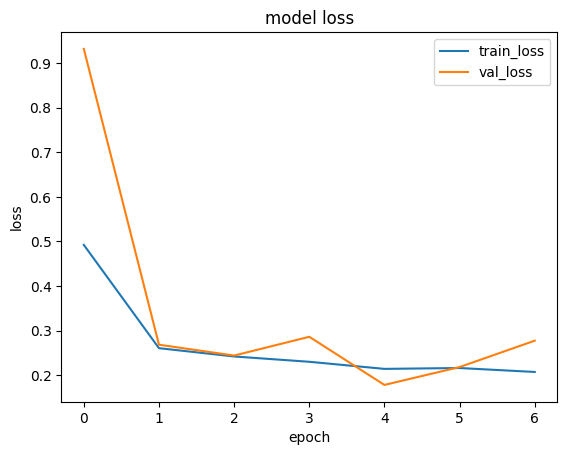

In [ ]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train_loss', 'val_loss'])
plt.show()

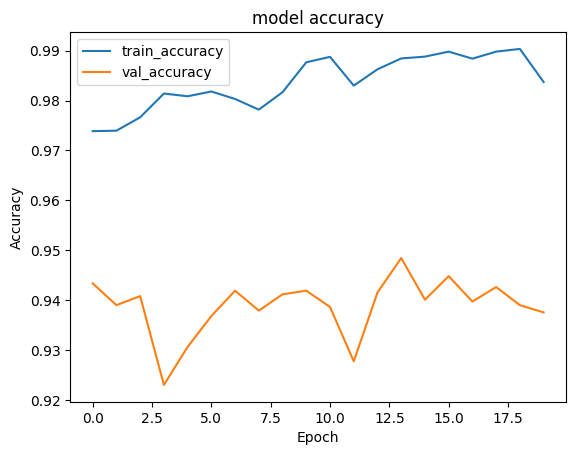

In [ ]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['train_accuracy', 'val_accuracy'])
plt.show()

**Model Evaluation & Testing**

In [ ]:
test_dataset = test_dataset.batch(1)

In [ ]:
train_dataset

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int64, name=None))>

In [ ]:
lenet_model.evaluate(test_dataset)

2757/2757 [==============================] - 26s 6ms/step - loss: 0.2967 - tp: 1343.0000 - fp: 230.0000 - tn: 1161.0000 - fn: 23.0000 - Accuracy: 0.9082 - precision: 0.8538 - recall: 0.9832 - auc: 0.9574


[0.2967187166213989,
 1343.0,
 230.0,
 1161.0,
 23.0,
 0.9082335829734802,
 0.853782594203949,
 0.983162522315979,
 0.9574112296104431]

**Visualizing Confusion Matrix**

In [ ]:
labels = []
inp = []
for x,y in test_dataset.as_numpy_iterator():
  labels.append(y)
  inp.append(x)

In [ ]:
print(labels)

[array([0]), array([0]), array([1]), array([0]), array([0]), array([1]), array([0]), array([1]), array([0]), array([1]), array([0]), array([0]), array([0]), array([1]), array([1]), array([0]), array([1]), array([1]), array([1]), array([1]), array([1]), array([1]), array([0]), array([1]), array([0]), array([0]), array([1]), array([0]), array([1]), array([1]), array([0]), array([1]), array([0]), array([0]), array([0]), array([0]), array([0]), array([0]), array([0]), array([0]), array([1]), array([0]), array([0]), array([1]), array([0]), array([1]), array([1]), array([0]), array([1]), array([0]), array([0]), array([0]), array([0]), array([1]), array([1]), array([1]), array([1]), array([1]), array([1]), array([1]), array([0]), array([0]), array([1]), array([0]), array([1]), array([0]), array([0]), array([1]), array([0]), array([0]), array([0]), array([1]), array([1]), array([1]), array([0]), array([1]), array([1]), array([1]), array([0]), array([1]), array([1]), array([1]), array([1]), arr

In [ ]:
print(np.array(inp).shape) #Eliminate the 1 in dim
print(np.array(inp)[:,0,...].shape)

(2757, 1, 224, 224, 3)
(2757, 224, 224, 3)


In [ ]:
labels = np.array([i[0] for i in labels])
labels

array([1, 0, 0, ..., 1, 0, 0])

In [ ]:
predicted = lenet_model.predict(np.array(inp)[:,0,...])
print(predicted.shape)
print(predicted[:,0].shape)

87/87 [==============================] - 1s 15ms/step
(2757, 1)
(2757,)


In [ ]:
print(predicted[:,0])

[0.9468582  0.00526257 0.00323401 ... 0.9619203  0.01146878 0.00184006]


[[1214  178]
 [  37 1328]]


Text(0.5, 58.7222222222222, 'Predicted')

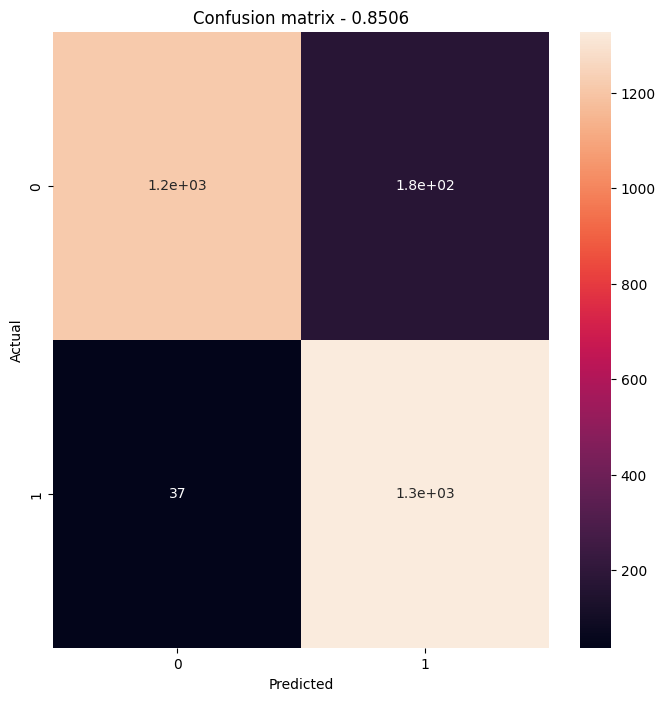

In [ ]:
threshold = 0.8506 # Change Threshold & Watch FP, FN,   it is manaual adjustement, Prefer to get from ROC curve

cm = confusion_matrix(labels, predicted > threshold)
print(cm)
plt.figure(figsize=(8,8))

sns.heatmap(cm, annot=True,)
plt.title('Confusion matrix - {}'.format(threshold))
plt.ylabel('Actual')
plt.xlabel('Predicted')

In [ ]:
# [TN   FP]
# [FN   TP]
# tp: 1343.0000 - fp: 230.0000 - tn: 1161.0000 - fn: 23.0000

In [ ]:
# Adjusting Threshold with ROC automatic

**ROC PLOTS**

In [ ]:
fp, tp, thresholds = roc_curve(labels, predicted)
print(len(fp),len(tp), len(thresholds))   ## Making sure there are equal points of each to plot

366 366 366


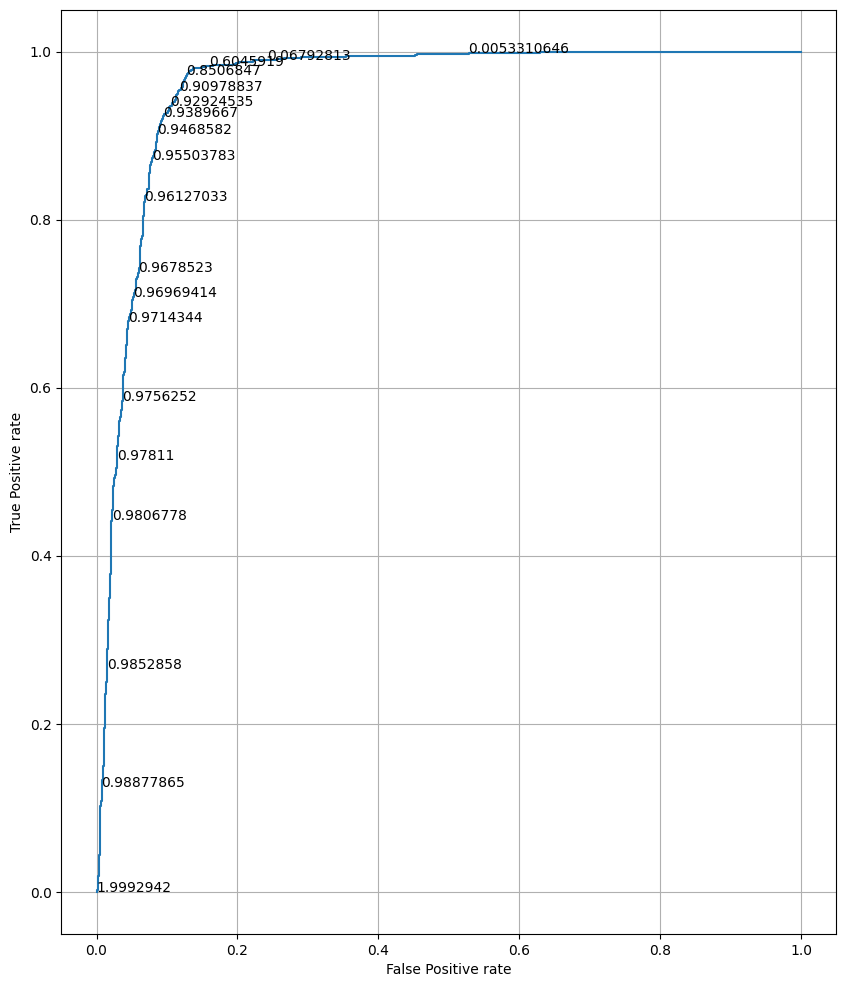

In [ ]:
plt.figure(figsize=(10, 12))
plt.plot(fp, tp)
plt.xlabel("False Positive rate")
plt.ylabel("True Positive rate")

plt.grid()

skip = 20

for i in range(0, len(thresholds), skip):
  plt.text(fp[i], tp[i], thresholds[i])

plt.show()

**Model Predicition**

In [ ]:
parasite_or_not(lenet_model.predict(test_dataset.take(1))[0][0])

1/1 [==============================] - 11s 11s/step


'U'

In [ ]:
def parasite_or_not(x):
  if(x < 0.5):
    return str('P')
  else:
    return str('U')

1/1 [==============================] - 0s 18ms/step


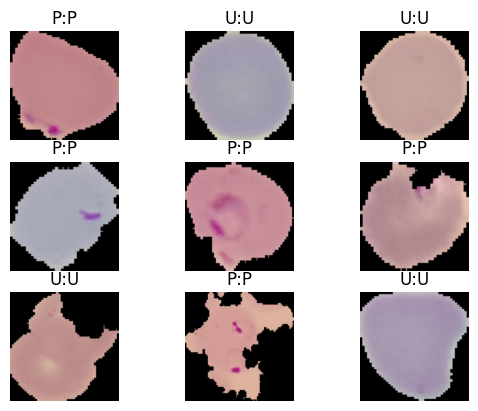

In [ ]:
for i, (image, label) in enumerate(test_dataset.take(9)):
  ax = plt.subplot(3, 3, i + 1)

  plt.imshow(image[0])
  plt.title(str(parasite_or_not(label.numpy()[0])) + ":" + str(parasite_or_not(lenet_model.predict(image)[0][0])))
  plt.axis('off')

**Saving & Loading Model**

In [ ]:
from google.colab import drive
lenet_model.save('lenet_saved_model') # save configuration and weights to "/content"
lenet_loaded_model = tf.keras.models.load_model("lenet_saved_model") # load model to your notebook instance

lenet_loaded_model.summary() # check if it's loaded proparty

drive.mount('/content/drive/') # mount google drive, it asks for your permission
!cp -r /content/lenet_saved_model/ /content/drive/MyDrive/lenet_saved_model/   # save your model from content to google drive
!cp -r /content/drive/MyDrive/lenet_saved_model/ /content/lenet_saved_model/   # save your model from google drive to content

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_4 (Conv2D)           (None, 222, 222, 6)       168       
                                                                 
 batch_normalization (Batch  (None, 222, 222, 6)       24        
 Normalization)                                                  
                                                                 
 max_pooling2d_4 (MaxPoolin  (None, 111, 111, 6)       0         
 g2D)                                                            
                                                                 
 conv2d_5 (Conv2D)           (None, 109, 109, 16)      880       
                                                                 
 batch_normalization_1 (Bat  (None, 109, 109, 16)      64        
 chNormalization)                                                
                                                      

In [ ]:
lenet_model.save('lenet.hdf5')

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
lenet_loaded_model = tf.keras.models.load_model("lenet.hdf5") # load model to your notebook instance

lenet_loaded_model.summary() # check if it's loaded proparty


Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_4 (Conv2D)           (None, 222, 222, 6)       168       
                                                                 
 batch_normalization (Batch  (None, 222, 222, 6)       24        
 Normalization)                                                  
                                                                 
 max_pooling2d_4 (MaxPoolin  (None, 111, 111, 6)       0         
 g2D)                                                            
                                                                 
 conv2d_5 (Conv2D)           (None, 109, 109, 16)      880       
                                                                 
 batch_normalization_1 (Bat  (None, 109, 109, 16)      64        
 chNormalization)                                                
                                                      

In [ ]:
# Saving only weights in case we already have configs
lenet_model.save_weights('weights/lenet_weights')

In [ ]:
# We recompiled the model & Tested it
lenet_model.evaluate(test_dataset)

2757/2757 [==============================] - 30s 6ms/step - loss: 0.6937 - accuracy: 0.4770


[0.6936702728271484, 0.4769677221775055]

In [ ]:
# Giving saved weights & Now testing
lenet_model.load_weights('weights/lenet_weights')
lenet_model.evaluate(test_dataset)

2757/2757 [==============================] - 26s 5ms/step - loss: 0.2220 - accuracy: 0.9343


[0.22200989723205566, 0.9343489408493042]